In [ ]:
# =====================================================================
# 0 – Installation (à exécuter une seule fois)
# =====================================================================
!pip install -q torch accelerate transformers datasets evaluate scikit-learn \
              matplotlib seaborn plotly xgboost lightgbm shap lime \
              huggingface_hub loguru nltk


In [ ]:
# =====================================================================
# 1 – Imports & répertoires
# =====================================================================
import os, re, json, warnings, nltk
from pathlib import Path
import numpy as np, pandas as pd
import plotly.express as px, plotly.graph_objs as go, plotly.figure_factory as ff
from loguru import logger
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing      import LabelEncoder, label_binarize
from sklearn.metrics            import (classification_report, accuracy_score,
                                        precision_score, recall_score, f1_score,
                                        roc_curve, auc, confusion_matrix)
from sklearn.svm                import LinearSVC
from sklearn.calibration        import CalibratedClassifierCV
from sklearn.ensemble           import RandomForestClassifier, VotingClassifier
from xgboost                    import XGBClassifier
from lightgbm                   import LGBMClassifier
import joblib, shap, lime.lime_text, torch, evaluate
from transformers               import (AutoTokenizer, AutoModelForSequenceClassification,
                                        DataCollatorWithPadding, Trainer,
                                        TrainingArguments, EarlyStoppingCallback, set_seed)

nltk.download("stopwords", quiet=True)
from nltk.corpus import stopwords
stop_list = set(stopwords.words("english"))

# Dossiers séparés pour la variante SW → on ne touche pas aux anciens artefacts
Path("models_sw").mkdir(exist_ok=True)
Path("tfidf_sw").mkdir(exist_ok=True)
set_seed(42)

# =====================================================================
# 2 – Chargement & fusion des données  (identique)
# =====================================================================
from datasets import load_dataset
ds  = load_dataset("zeroshot/twitter-financial-news-sentiment", split="train")
df1 = ds.to_pandas()
df1["label"] = df1["label"].map({0:"negative",1:"positive",2:"neutral"})
df1["input"] = df1["text"]

ds2 = load_dataset("FinGPT/fingpt-sentiment-train", split="train")
df2 = ds2.to_pandas()
def simplify(lbl):
    lbl = lbl.lower()
    if   "very positive" in lbl or "strongly positive" in lbl: return "very positive"
    elif "positive"      in lbl: return "positive"
    elif "very negative" in lbl or "strongly negative" in lbl: return "very negative"
    elif "negative"      in lbl: return "negative"
    else:                        return "neutral"
df2["label"] = df2["output"].apply(simplify)
df2          = df2[["input","label"]]

df_combined  = pd.concat([df1[["input","label"]], df2], ignore_index=True)
print(df_combined["label"].value_counts())


2025-04-27 14:59:21.734721: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-04-27 14:59:21.734779: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-04-27 14:59:21.735853: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-27 14:59:21.741876: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-04-27 14:59:22.552731: W tensorflow/compiler/tf2

label
neutral     35393
positive    32433
negative    18489
Name: count, dtype: int64


In [ ]:
# =====================================================================
# 3 – Nettoyage + split  (stop-words retirés)
# =====================================================================
fin_stop = {"shares","stock","stocks","company","companies"}     # exemple mini-lexique
all_stop = stop_list | fin_stop

def clean_text(txt:str) -> str:
    txt = re.sub(r"http\S+|@\w+|[^a-zA-Z0-9\s]", " ", txt).lower()
    tokens = [w for w in txt.split() if w not in all_stop]
    return " ".join(tokens)

df_combined["input"] = df_combined["input"].astype(str).apply(clean_text)

train_df, tmp = train_test_split(df_combined, test_size=0.30,
                                 stratify=df_combined["label"], random_state=42)
val_df, test_df = train_test_split(tmp, test_size=2/3,
                                   stratify=tmp["label"], random_state=42)
print(f"Train {len(train_df)} | Val {len(val_df)} | Test {len(test_df)}")

Train 60420 | Val 8631 | Test 17264


In [ ]:
# =====================================================================
# 4 – Vectorisation TF-IDF  (nouveau cache « tfidf_sw »)
# =====================================================================
from sklearn.exceptions import NotFittedError
vec_path = Path("tfidf_sw/tfidf_vect_sw.joblib")

def _is_fitted(v):
    try: v.transform(["test"]); return True
    except NotFittedError:      return False

if vec_path.exists() and _is_fitted(joblib.load(vec_path)):
    vectorizer = joblib.load(vec_path)
    logger.info("✓ TF-IDF SW rechargé")
else:
    logger.info("⏳ Entraînement TF-IDF sans stop-words…")
    vectorizer = TfidfVectorizer(max_features=10_000,
                                 ngram_range=(1,2),
                                 stop_words=all_stop)
    vectorizer.fit(train_df["input"])
    joblib.dump(vectorizer, vec_path)
    logger.success("✓ Sauvegardé → %s", vec_path)

X_train = vectorizer.transform(train_df["input"])
X_val   = vectorizer.transform(val_df["input"])
X_test  = vectorizer.transform(test_df["input"])

# Encodage labels ------------------------------------------------------
le_path = Path("tfidf_sw/label_encoder.joblib")
le = joblib.load(le_path) if le_path.exists() else LabelEncoder().fit(train_df["label"])
joblib.dump(le, le_path)
y_train, y_val, y_test = map(le.transform, [train_df["label"], val_df["label"], test_df["label"]])
classes = le.classes_

2025-04-27 14:59:31.126 | INFO     | __main__:<module>:13 - ✓ TF-IDF SW rechargé


In [ ]:
# =====================================================================
# 5 – Fonctions utilitaires  (identiques à l’ancienne version)
# =====================================================================
def store_metrics(name, y_true, y_pred, store: list):
    store.append({
        "Modèle":          name,
        "Accuracy":        accuracy_score (y_true, y_pred),
        "F1 macro":        f1_score       (y_true, y_pred, average="macro"),
        "Precision macro": precision_score(y_true, y_pred, average="macro"),
        "Recall macro":    recall_score   (y_true, y_pred, average="macro"),
    })
    print(f"\n=== {name} ===")
    print(classification_report(y_true, y_pred, target_names=classes, digits=3))


def roc_plotly(name, y_score):
    """Courbe ROC multi-classe (One-vs-Rest)."""
    y_bin = label_binarize(y_test, classes=range(len(classes)))
    fig   = go.Figure()
    for i, lbl in enumerate(classes):
        fpr, tpr, _ = roc_curve(y_bin[:, i], y_score[:, i])
        fig.add_trace(go.Scatter(x=fpr, y=tpr, mode="lines",
                                 name=f"{lbl} (AUC {auc(fpr, tpr):.2f})"))
    fig.add_shape(type="line", x0=0, y0=0, x1=1, y1=1,
                  line=dict(dash="dash", color="gray"))
    fig.update_layout(title=f"ROC – {name}",
                      xaxis_title="FPR", yaxis_title="TPR",
                      width=700, height=500)
    fig.show()


In [ ]:
# =====================================================================
# 6 – Modèles classiques (stockés dans « models_sw »)
# =====================================================================
metrics = []

# --- SVM linéaire -----------------------------------------------------
svm_p      = Path("models_sw/linear_svc_sw.joblib")
svm_cal_p  = Path("models_sw/linear_svc_cal_sw.joblib")
if svm_p.exists() and svm_cal_p.exists():
    svm_best, svm_calib = joblib.load(svm_p), joblib.load(svm_cal_p)
else:
    svm_cv     = GridSearchCV(LinearSVC(), {"C": [0.01, 0.1, 1, 10]},
                              cv=3, scoring="f1_macro", n_jobs=-1).fit(X_train, y_train)
    svm_best   = svm_cv.best_estimator_
    svm_calib  = CalibratedClassifierCV(svm_best, cv=3).fit(X_train, y_train)
    joblib.dump(svm_best,  svm_p)
    joblib.dump(svm_calib, svm_cal_p)
store_metrics("SVM-SW", y_test, svm_best.predict(X_test), metrics)

# --- Random Forest ----------------------------------------------------
rf_p = Path("models_sw/random_forest_sw.joblib")
if rf_p.exists():
    rf_best = joblib.load(rf_p)
else:
    rf_cv   = GridSearchCV(RandomForestClassifier(),
                           {"n_estimators": [100, 200], "max_depth": [None, 10, 20]},
                           cv=3, scoring="f1_macro", n_jobs=-1).fit(X_train, y_train)
    rf_best = rf_cv.best_estimator_
    joblib.dump(rf_best, rf_p)
store_metrics("RF-SW", y_test, rf_best.predict(X_test), metrics)

# --- XGBoost ----------------------------------------------------------
xgb_p = Path("models_sw/xgboost_sw.joblib")
if xgb_p.exists():
    xgb_best = joblib.load(xgb_p)
else:
    xgb_cv   = GridSearchCV(
        XGBClassifier(tree_method="hist", use_label_encoder=False, eval_metric="mlogloss"),
        {"n_estimators": [100, 200]}, cv=3, scoring="f1_macro", n_jobs=-1
    ).fit(X_train, y_train)
    xgb_best = xgb_cv.best_estimator_
    joblib.dump(xgb_best, xgb_p)
store_metrics("XGB-SW", y_test, xgb_best.predict(X_test), metrics)

# --- LightGBM ---------------------------------------------------------
lgb_p = Path("models_sw/lightgbm_sw.joblib")
if lgb_p.exists():
    lgb_best = joblib.load(lgb_p)
else:
    lgb_cv   = GridSearchCV(LGBMClassifier(),
                            {"n_estimators": [100, 200]}, cv=3,
                            scoring="f1_macro", n_jobs=-1).fit(X_train, y_train)
    lgb_best = lgb_cv.best_estimator_
    joblib.dump(lgb_best, lgb_p)
store_metrics("LGBM-SW", y_test, lgb_best.predict(X_test), metrics)

# --- Voting soft ------------------------------------------------------
vote_p = Path("models_sw/voting_soft_sw.joblib")
if vote_p.exists():
    voting = joblib.load(vote_p)
else:
    voting = VotingClassifier(
        estimators=[("svm", svm_calib), ("rf", rf_best),
                    ("xgb", xgb_best), ("lgbm", lgb_best)],
        voting="soft", n_jobs=-1
    ).fit(X_train, y_train)
    joblib.dump(voting, vote_p)
store_metrics("Voting-SW", y_test, voting.predict(X_test), metrics)

pd.DataFrame(metrics).round(3)



=== SVM-SW ===
              precision    recall  f1-score   support

    negative      0.875     0.827     0.850      3698
     neutral      0.891     0.927     0.909      7079
    positive      0.890     0.878     0.884      6487

    accuracy                          0.887     17264
   macro avg      0.885     0.877     0.881     17264
weighted avg      0.887     0.887     0.887     17264


=== RF-SW ===
              precision    recall  f1-score   support

    negative      0.962     0.808     0.878      3698
     neutral      0.942     0.960     0.951      7079
    positive      0.880     0.942     0.910      6487

    accuracy                          0.921     17264
   macro avg      0.928     0.903     0.913     17264
weighted avg      0.923     0.921     0.920     17264


=== XGB-SW ===
              precision    recall  f1-score   support

    negative      0.906     0.680     0.776      3698
     neutral      0.797     0.943     0.864      7079
    positive      0.860     

,Modèle,Accuracy,F1 macro,Precision macro,Recall macro
0,SVM-SW,0.887,0.881,0.885,0.877
1,RF-SW,0.921,0.913,0.928,0.903
2,XGB-SW,0.837,0.825,0.854,0.811
3,LGBM-SW,0.847,0.837,0.856,0.827
4,Voting-SW,0.911,0.904,0.916,0.895


In [ ]:
# =====================================================================
# 7 – ROC curves pour la variante sans stop-words
# =====================================================================
model_scores = {
    "SVM-SW":    svm_calib.predict_proba(X_test),
    "RF-SW":     rf_best.predict_proba(X_test),
    "XGB-SW":    xgb_best.predict_proba(X_test),
    "LGBM-SW":   lgb_best.predict_proba(X_test),
    "Voting-SW": voting.predict_proba(X_test)
}
for name, score in model_scores.items():
    roc_plotly(name, score)


In [ ]:
# =====================================================================
# 8 – Fine-tuning Transformers (checkpoints dédiés « *_sw_sent »)
# =====================================================================
label_list = list(classes)
label2id   = {l: i for i, l in enumerate(label_list)}
id2label   = {i: l for l, i in label2id.items()}

from datasets import Dataset
def hf_dataset(df):
    return (Dataset
            .from_pandas(df[["input", "label"]].reset_index(drop=True))
            .map(lambda ex: {"labels": label2id[ex["label"]]},
                 remove_columns=["label"]))

train_ds, val_ds, test_ds = map(hf_dataset, [train_df, val_df, test_df])

def run_transformer_sw(model_name: str):
    ckpt_dir = Path(f"models_sw/{model_name.replace('/', '_')}_sw_sent")

    # --- reprise éventuelle -------------------------------------------
    if (ckpt_dir / "pytorch_model.bin").exists():
        src = ckpt_dir
    else:
        ckpts = sorted(ckpt_dir.glob("checkpoint-*"))
        src   = ckpts[-1] if ckpts else None

    if src:
        model = AutoModelForSequenceClassification.from_pretrained(src)
        tok   = AutoTokenizer.from_pretrained(src)
    else:
        tok   = AutoTokenizer.from_pretrained(model_name)
        model = AutoModelForSequenceClassification.from_pretrained(
            model_name, num_labels=len(label_list),
            id2label=id2label, label2id=label2id)

    def tok_map(ex):
        return tok(ex["input"], padding="max_length",
                   truncation=True, max_length=128)

    tr_tok = train_ds.map(tok_map, batched=True).remove_columns(["input"])
    va_tok = val_ds  .map(tok_map, batched=True).remove_columns(["input"])
    te_tok = test_ds .map(tok_map, batched=True).remove_columns(["input"])
    coll   = DataCollatorWithPadding(tok)

    args = TrainingArguments(
        output_dir             = ckpt_dir,
        evaluation_strategy    = "epoch",
        save_strategy          = "epoch",
        load_best_model_at_end = True,
        metric_for_best_model  = "f1",
        num_train_epochs       = 3,
        per_device_train_batch_size = 8,
        per_device_eval_batch_size  = 8,
        fp16                   = torch.cuda.is_available(),
        logging_steps          = 100,
        save_total_limit       = 1,
        report_to              = "none",
    )
    def metrics(p):
        preds = p.predictions.argmax(1)
        return {"accuracy": accuracy_score(p.label_ids, preds),
                "f1":       f1_score(p.label_ids, preds, average="macro")}

    if not src:
        Trainer(model=model, args=args,
                train_dataset=tr_tok, eval_dataset=va_tok,
                tokenizer=tok, data_collator=coll,
                compute_metrics=metrics,
                callbacks=[EarlyStoppingCallback(1)]
        ).train()
        model.save_pretrained(ckpt_dir)
        tok.save_pretrained(ckpt_dir)

    y_pred = Trainer(model=model, args=args).predict(te_tok).predictions.argmax(1)
    print(f"\n=== {model_name} (SW) – Test ===")
    print(classification_report(test_ds["labels"], y_pred,
                                target_names=label_list, digits=3))

for m in ["ProsusAI/finbert",
          "bert-base-uncased",
          "distilbert-base-uncased",
          "roberta-base"]:
    run_transformer_sw(m)


Map:   0%|          | 0/60420 [00:00<?, ? examples/s]

Map:   0%|          | 0/8631 [00:00<?, ? examples/s]

Map:   0%|          | 0/17264 [00:00<?, ? examples/s]

Map:   0%|          | 0/60420 [00:00<?, ? examples/s]

Map:   0%|          | 0/8631 [00:00<?, ? examples/s]

Map:   0%|          | 0/17264 [00:00<?, ? examples/s]


=== ProsusAI/finbert (SW) – Test ===
              precision    recall  f1-score   support

    negative      0.919     0.916     0.917      3698
     neutral      0.957     0.957     0.957      7079
    positive      0.934     0.935     0.934      6487

    accuracy                          0.940     17264
   macro avg      0.937     0.936     0.936     17264
weighted avg      0.940     0.940     0.940     17264



Map:   0%|          | 0/60420 [00:00<?, ? examples/s]

Map:   0%|          | 0/8631 [00:00<?, ? examples/s]

Map:   0%|          | 0/17264 [00:00<?, ? examples/s]


=== bert-base-uncased (SW) – Test ===
              precision    recall  f1-score   support

    negative      0.927     0.909     0.918      3698
     neutral      0.959     0.958     0.959      7079
    positive      0.931     0.942     0.936      6487

    accuracy                          0.942     17264
   macro avg      0.939     0.936     0.938     17264
weighted avg      0.942     0.942     0.942     17264



Map:   0%|          | 0/60420 [00:00<?, ? examples/s]

Map:   0%|          | 0/8631 [00:00<?, ? examples/s]

Map:   0%|          | 0/17264 [00:00<?, ? examples/s]


=== distilbert-base-uncased (SW) – Test ===
              precision    recall  f1-score   support

    negative      0.925     0.908     0.916      3698
     neutral      0.956     0.957     0.956      7079
    positive      0.928     0.938     0.933      6487

    accuracy                          0.939     17264
   macro avg      0.936     0.934     0.935     17264
weighted avg      0.939     0.939     0.939     17264



Map:   0%|          | 0/60420 [00:00<?, ? examples/s]

Map:   0%|          | 0/8631 [00:00<?, ? examples/s]

Map:   0%|          | 0/17264 [00:00<?, ? examples/s]


=== roberta-base (SW) – Test ===
              precision    recall  f1-score   support

    negative      0.000     0.000     0.000      3698
     neutral      0.410     1.000     0.582      7079
    positive      0.000     0.000     0.000      6487

    accuracy                          0.410     17264
   macro avg      0.137     0.333     0.194     17264
weighted avg      0.168     0.410     0.238     17264



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



=== SHAP analysis (XGBoost, stop-words removed) ===


/tmp/ipykernel_315/1321538567.py:8: FutureWarning:

The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.



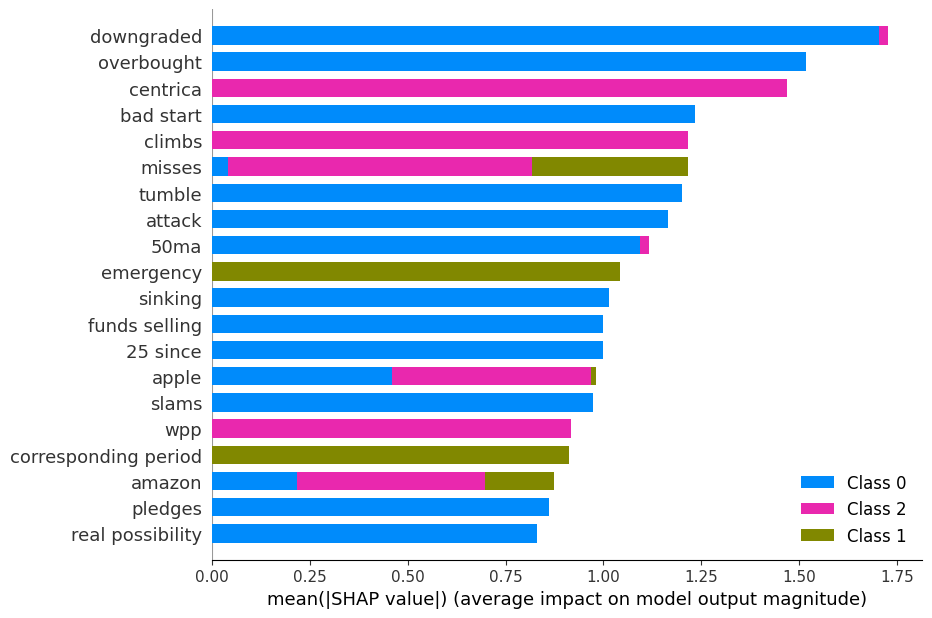


── LIME ► NEGATIVE (correct)
[('high', -0.1859963111539332), ('still', -0.13036962360141782), ('management', -0.09214434175509605), ('forecasts', -0.06805515751239931), ('2009', 0.038619714394177475), ('aktia', -0.037963422961968175), ('finnish', 0.026645109796287477), ('analysts', -0.020018857337911984), ('asset', 0.013081011822598406), ('according', 0.0016412159930575287)]

── LIME ► NEGATIVE (mis-classified as positive)
[('long', -0.0753007636236408), ('robust', -0.07019883378422394), ('semiconductor', -0.0689514133342209), ('investors', -0.06895118635494761), ('rally', -0.04294868478610525), ('slowing', -0.04182092475736538), ('week', 0.022454627514645935), ('mixed', 0.01866300396970347), ('warned', -0.014489444204549364), ('weigh', 0.013267039933103431)]

── LIME ► NEUTRAL (correct)
[('plan', 0.07294415467504593), ('office', 0.05546711233314954), ('books', 0.04545488775150813), ('wework', -0.02998951489124298), ('escape', 0.012865392497462626), ('tokyo', 0.002281648339985746), ('

In [ ]:
# =====================================================================
# 9 – Explainability & Error analysis  (SHAP, LIME, stats)
# =====================================================================
print("=== SHAP analysis (XGBoost, stop-words removed) ===")
xgb_explainer = shap.Explainer(xgb_best)
xgb_sample    = X_test[:200].toarray().astype("float64")
xgb_shap_vals = xgb_explainer(xgb_sample)
shap.summary_plot(
    xgb_shap_vals, xgb_sample,
    feature_names=vectorizer.get_feature_names_out(),
    max_display=20, show=False
)
plt.gcf().set_size_inches(10, 6)
plt.show()

# ---- LIME sur Voting -------------------------------------------------
lime_exp = lime.lime_text.LimeTextExplainer(class_names=classes)
test_df["pred"] = le.inverse_transform(voting.predict(X_test))

examples = {}
for lbl in classes:
    ok  = test_df[(test_df["label"] == lbl) & (test_df["pred"] == lbl)].index
    ko  = test_df[(test_df["label"] == lbl) & (test_df["pred"] != lbl)].index
    examples[lbl] = (ok[0] if len(ok) else None, ko[0] if len(ko) else None)

for lbl, (i_ok, i_ko) in examples.items():
    if i_ok is not None:
        print(f"\n── LIME ► {lbl.upper()} (correct)")
        print(lime_exp.explain_instance(test_df.loc[i_ok, "input"],
                                        lambda t: voting.predict_proba(vectorizer.transform(t)),
                                        num_features=10).as_list())
    if i_ko is not None:
        print(f"\n── LIME ► {lbl.upper()} (mis-classified as {test_df.loc[i_ko,'pred']})")
        print(lime_exp.explain_instance(test_df.loc[i_ko, "input"],
                                        lambda t: voting.predict_proba(vectorizer.transform(t)),
                                        num_features=10).as_list())

# ---- Statistiques d’erreurs -----------------------------------------
err = test_df[test_df["label"] != test_df["pred"]]
print("\n=== Error patterns ===")
print(err.groupby(["label", "pred"]).size()
          .reset_index(name="count")
          .sort_values("count", ascending=False))

print("\n=== Error rate by class ===")
for lbl in classes:
    tot = (test_df["label"] == lbl).sum()
    mis = (err["label"]   == lbl).sum()
    print(f"{lbl:>8}: {mis}/{tot}  ({mis / tot * 100:.2f} %)")

# Histogramme longueur texte ------------------------------------------
test_df["len"]      = test_df["input"].str.len()
test_df["is_error"] = test_df["label"] != test_df["pred"]
px.histogram(
    test_df, x="len", color="is_error", nbins=40, barmode="overlay",
    color_discrete_map={False: "#1f77b4", True: "#d62728"},
    labels={"len": "Text length", "is_error": "Mis-classified"},
    title="Text length – Errors vs Correct (stop-words removed)"
).show()

# Matrice de confusion -------------------------------------------------
cm     = confusion_matrix(test_df["label"], test_df["pred"], labels=classes)
cm_pct = np.divide(cm, cm.sum(axis=1, keepdims=True),
                   out=np.zeros_like(cm, dtype=float),
                   where=cm.sum(axis=1, keepdims=True)!=0) * 100
annot  = [[f"{cm[i,j]}<br>({cm_pct[i,j]:.1f} %)"
           for j in range(len(classes))]
           for i in range(len(classes))]
ff.create_annotated_heatmap(
    z=cm, x=list(classes), y=list(classes),
    annotation_text=annot, colorscale="Blues"
).update_layout(
    title="Confusion Matrix – Voting-SW",
    xaxis_title="Predicted", yaxis_title="True",
    width=700, height=600
).update_xaxes(side="bottom").show()


In [ ]:
# =====================================================================
# 10 – Sauvegarde finale (variante SW)
# =====================================================================
joblib.dump(voting,    "models_sw/best_voting_sw.joblib")
joblib.dump(vectorizer,"tfidf_sw/tfidf_vect_sw.joblib")
print("✓ Modèle Voting-SW et TF-IDF-SW sauvegardés.")


✓ Modèle Voting-SW et TF-IDF-SW sauvegardés.
